# <center>**PRÁCTICA 1:** **APRENDIZAJE NO SUPERVISADO (DengAI)**<center>

**Grupo número**:
* **Estudiante 1**: Diego Felipe Pulido Sastoque
* **Estudiante 2**: Mauricio Andrés Sáenz Sastoque

---
# **Resumen**
---

Para la realización de esta actividad se utilizó el conjunto de datos de entrenamiento "dengue_features_train.csv". Como primeros pasos se cargó este archivo y se visualizó la información que contiene. Luego, en el preprocesado se usaron funciones y tranformaciones de los datos con el fin de preparar todas las variables para su exploración. En este paso se verificaron valores perdidos y se usó la transformación de variables.

En el apartado de características se realizó el análisis estadístico del conjunto de datos y se aplicó la detección de outliers. Posterior a estos pasos se aplicaron diversos métodos de correlación de variables para determinar cuales son más representativas y así realizar una reducción de variables en el conjunto de datos. Se utilizaron métodos como análisis por mapa de calor, análisis por componentes principales, k-means, clustering jerárquico y clustering basado en densidad. De los últimos 3 métodos mencionados se observaron las siguientes variables en común en sus resultados:



1.   reanalysis_relative_humidity_percent
2.   reanalysis_avg_temp_k
3.   reanalysis_air_temp_k
4.   reanalysis_dew_point_temp_k
5.   reanalysis_precip_amt_kg_per_m2
6.   year
7.   weekofyear

Las variables "year" y "weekofyear" se tuvieron en cuenta también con el objetivo de continuar el trabajo para la práctica 2 en la que se debe generar la respuesta a la cantidad de contagios en una semana específica del año.

---
# **Inicialización**
---

In [ ]:
# Imports generales
import pandas as pd
import io
from google.colab import files

def upload_files (index_fields=None):
  uploaded = files.upload()
  for fn in uploaded.keys():
    print('User uploaded file "{name}" with length {length} bytes'.format(
        name=fn, length=len(uploaded[fn])))
    df = pd.read_csv(io.StringIO(uploaded[fn].decode('utf-8')), index_col = index_fields)
    return df

In [ ]:
# Subir el conjunto de entrenamiento sin variable objetivo (dengue_features_train.csv)
train = upload_files()
print(train.shape)
train.head()

Saving dengue_features_train.csv to dengue_features_train.csv
User uploaded file "dengue_features_train.csv" with length 287139 bytes
(1456, 24)


,city,year,weekofyear,week_start_date,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,precipitation_amt_mm,reanalysis_air_temp_k,...,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm
0,sj,1990,18,1990-04-30,0.122600,0.103725,0.198483,0.177617,12.42,297.572857,...,32.00,73.365714,12.42,14.012857,2.628571,25.442857,6.900000,29.4,20.0,16.0
1,sj,1990,19,1990-05-07,0.169900,0.142175,0.162357,0.155486,22.82,298.211429,...,17.94,77.368571,22.82,15.372857,2.371429,26.714286,6.371429,31.7,22.2,8.6
2,sj,1990,20,1990-05-14,0.032250,0.172967,0.157200,0.170843,34.54,298.781429,...,26.10,82.052857,34.54,16.848571,2.300000,26.714286,6.485714,32.2,22.8,41.4
3,sj,1990,21,1990-05-21,0.128633,0.245067,0.227557,0.235886,15.36,298.987143,...,13.90,80.337143,15.36,16.672857,2.428571,27.471429,6.771429,33.3,23.3,4.0
4,sj,1990,22,1990-05-28,0.196200,0.262200,0.251200,0.247340,7.52,299.518571,...,12.20,80.460000,7.52,17.210000,3.014286,28.942857,9.371429,35.0,23.9,5.8


In [ ]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 24 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   city                                   1456 non-null   object 
 1   year                                   1456 non-null   int64  
 2   weekofyear                             1456 non-null   int64  
 3   week_start_date                        1456 non-null   object 
 4   ndvi_ne                                1262 non-null   float64
 5   ndvi_nw                                1404 non-null   float64
 6   ndvi_se                                1434 non-null   float64
 7   ndvi_sw                                1434 non-null   float64
 8   precipitation_amt_mm                   1443 non-null   float64
 9   reanalysis_air_temp_k                  1446 non-null   float64
 10  reanalysis_avg_temp_k                  1446 non-null   float64
 11  rean

---
# **Preprocesado**
---

In [ ]:
#Eliminar variable week_start_date por ser de tipo cadena de texto sin formato
train.drop("week_start_date", axis = 1, inplace = True)

## **Valores Perdidos**

In [ ]:
# Contar valores perdidos
train.isnull().sum()

city                                       0
year                                       0
weekofyear                                 0
ndvi_ne                                  194
ndvi_nw                                   52
ndvi_se                                   22
ndvi_sw                                   22
precipitation_amt_mm                      13
reanalysis_air_temp_k                     10
reanalysis_avg_temp_k                     10
reanalysis_dew_point_temp_k               10
reanalysis_max_air_temp_k                 10
reanalysis_min_air_temp_k                 10
reanalysis_precip_amt_kg_per_m2           10
reanalysis_relative_humidity_percent      10
reanalysis_sat_precip_amt_mm              13
reanalysis_specific_humidity_g_per_kg     10
reanalysis_tdtr_k                         10
station_avg_temp_c                        43
station_diur_temp_rng_c                   43
station_max_temp_c                        20
station_min_temp_c                        14
station_pr

In [ ]:
# Calcular la mediana de todas las columnas
mediana = train.select_dtypes(include='number').median()

In [ ]:
# Imputar los valores faltantes con la mediana
train= train.fillna(mediana)

In [ ]:
# Verificar la calidad de la imputación solo para las variables numéricas
numeric_cols = train.select_dtypes(include='number').columns.tolist()
mse = ((train[numeric_cols] - train[numeric_cols].fillna(mediana)) ** 2).mean(axis=0)
print('MSE:', mse)

MSE: year                                     0.0
weekofyear                               0.0
ndvi_ne                                  0.0
ndvi_nw                                  0.0
ndvi_se                                  0.0
ndvi_sw                                  0.0
precipitation_amt_mm                     0.0
reanalysis_air_temp_k                    0.0
reanalysis_avg_temp_k                    0.0
reanalysis_dew_point_temp_k              0.0
reanalysis_max_air_temp_k                0.0
reanalysis_min_air_temp_k                0.0
reanalysis_precip_amt_kg_per_m2          0.0
reanalysis_relative_humidity_percent     0.0
reanalysis_sat_precip_amt_mm             0.0
reanalysis_specific_humidity_g_per_kg    0.0
reanalysis_tdtr_k                        0.0
station_avg_temp_c                       0.0
station_diur_temp_rng_c                  0.0
station_max_temp_c                       0.0
station_min_temp_c                       0.0
station_precip_mm                        0.0
dtype

In [ ]:
# Se vuelve a verificar la cantidad de valores perdidos
train.isnull().sum()

city                                     0
year                                     0
weekofyear                               0
ndvi_ne                                  0
ndvi_nw                                  0
ndvi_se                                  0
ndvi_sw                                  0
precipitation_amt_mm                     0
reanalysis_air_temp_k                    0
reanalysis_avg_temp_k                    0
reanalysis_dew_point_temp_k              0
reanalysis_max_air_temp_k                0
reanalysis_min_air_temp_k                0
reanalysis_precip_amt_kg_per_m2          0
reanalysis_relative_humidity_percent     0
reanalysis_sat_precip_amt_mm             0
reanalysis_specific_humidity_g_per_kg    0
reanalysis_tdtr_k                        0
station_avg_temp_c                       0
station_diur_temp_rng_c                  0
station_max_temp_c                       0
station_min_temp_c                       0
station_precip_mm                        0
dtype: int6

**Explicación:**

Se eligió la imputación por mediana porque la cantidad de datos faltantes es bajo con respecto al total de datos, además de, preserva la distribución de los datos, es robusta a valores extremos y es de fácil implementación.
Utilizamos el método select_dtypes() de Pandas para seleccionar solo las columnas numéricas en el conjunto de datos. Luego, utilizamos la función median() de Pandas para calcular la mediana de todas las columnas numéricas.

Después de calcular la mediana, utilizamos la función fillna() de Pandas para reemplazar todos los valores faltantes en las columnas numéricas del conjunto de datos con la mediana correspondiente.

Finalmente, verificamos la calidad de la imputación calculando el error cuadrático medio entre los datos originales y los datos imputados solo para las variables numéricas. Esto nos ayuda a evaluar la calidad de la imputación y a determinar si es necesario utilizar técnicas más avanzadas de imputación o limpieza de datos. En este caso, todas las variables numéricas tienen un MSE de cero, lo que sugiere que la imputación por mediana fue exitosa y no hubo diferencias significativas entre los valores imputados y los valores originales para estas variables.

In [ ]:
# EJEMPLO: Completar valores perdidos con método ffill
# Alternativa: https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.interpolate.html#pandas.DataFrame.interpolate
#train.fillna(method='ffill', inplace=True)
#pd.isnull(train).any()

## **Transformación de Variables**

In [ ]:
# Binarizador para la variable categórica city en el conjunto de entrenamiento y test
from sklearn import preprocessing
lb = preprocessing.LabelBinarizer()
train['city_bin'] = lb.fit_transform(train['city'])

train.head()

,city,year,weekofyear,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,precipitation_amt_mm,reanalysis_air_temp_k,reanalysis_avg_temp_k,...,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm,city_bin
0,sj,1990,18,0.122600,0.103725,0.198483,0.177617,12.42,297.572857,297.742857,...,73.365714,12.42,14.012857,2.628571,25.442857,6.900000,29.4,20.0,16.0,1
1,sj,1990,19,0.169900,0.142175,0.162357,0.155486,22.82,298.211429,298.442857,...,77.368571,22.82,15.372857,2.371429,26.714286,6.371429,31.7,22.2,8.6,1
2,sj,1990,20,0.032250,0.172967,0.157200,0.170843,34.54,298.781429,298.878571,...,82.052857,34.54,16.848571,2.300000,26.714286,6.485714,32.2,22.8,41.4,1
3,sj,1990,21,0.128633,0.245067,0.227557,0.235886,15.36,298.987143,299.228571,...,80.337143,15.36,16.672857,2.428571,27.471429,6.771429,33.3,23.3,4.0,1
4,sj,1990,22,0.196200,0.262200,0.251200,0.247340,7.52,299.518571,299.664286,...,80.460000,7.52,17.210000,3.014286,28.942857,9.371429,35.0,23.9,5.8,1


In [ ]:
train.tail()

,city,year,weekofyear,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,precipitation_amt_mm,reanalysis_air_temp_k,reanalysis_avg_temp_k,...,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm,city_bin
1451,iq,2010,21,0.342750,0.318900,0.256343,0.292514,55.30,299.334286,300.771429,...,88.765714,55.30,18.485714,9.800000,28.633333,11.933333,35.4,22.4,27.0,0
1452,iq,2010,22,0.160157,0.160371,0.136043,0.225657,86.47,298.330000,299.392857,...,91.600000,86.47,18.070000,7.471429,27.433333,10.500000,34.7,21.7,36.6,0
1453,iq,2010,23,0.247057,0.146057,0.250357,0.233714,58.94,296.598571,297.592857,...,94.280000,58.94,17.008571,7.500000,24.400000,6.900000,32.2,19.2,7.4,0
1454,iq,2010,24,0.333914,0.245771,0.278886,0.325486,59.67,296.345714,297.521429,...,94.660000,59.67,16.815714,7.871429,25.433333,8.733333,31.2,21.0,16.0,0
1455,iq,2010,25,0.298186,0.232971,0.274214,0.315757,63.22,298.097143,299.835714,...,89.082857,63.22,17.355714,11.014286,27.475000,9.900000,33.7,22.2,20.4,0


In [ ]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 24 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   city                                   1456 non-null   object 
 1   year                                   1456 non-null   int64  
 2   weekofyear                             1456 non-null   int64  
 3   ndvi_ne                                1456 non-null   float64
 4   ndvi_nw                                1456 non-null   float64
 5   ndvi_se                                1456 non-null   float64
 6   ndvi_sw                                1456 non-null   float64
 7   precipitation_amt_mm                   1456 non-null   float64
 8   reanalysis_air_temp_k                  1456 non-null   float64
 9   reanalysis_avg_temp_k                  1456 non-null   float64
 10  reanalysis_dew_point_temp_k            1456 non-null   float64
 11  rean

**Explicación**

Se utilizó el código de binarizador para la variable categórica "city" con el fin de poder usar esta variable en futuros cálculos que solo usen variables numéricas, además de, poder clasificar los datos según su ciudad mediante una variable numérica.



---
# **Características**
---

## **Análisis Estadístico**

In [ ]:
train.describe()

,year,weekofyear,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,precipitation_amt_mm,reanalysis_air_temp_k,reanalysis_avg_temp_k,reanalysis_dew_point_temp_k,...,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm,city_bin
count,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,...,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000,1456.000000
mean,2001.031593,26.503434,0.140498,0.130227,0.203666,0.202111,45.694135,298.701472,299.226016,295.249065,...,82.149181,45.694135,16.748767,4.889698,27.192532,8.036903,32.457212,22.103091,39.092514,0.642857
std,5.408314,15.019437,0.130908,0.117847,0.073305,0.083281,43.525407,1.357737,1.257383,1.522899,...,7.130928,43.525407,1.537442,3.538279,1.273696,2.100818,1.946226,1.566504,47.133032,0.479322
min,1990.000000,1.000000,-0.406250,-0.456100,-0.015533,-0.063457,0.000000,294.635714,294.892857,289.642857,...,57.787143,0.000000,11.715714,1.357143,21.400000,4.528571,26.700000,14.700000,0.000000,0.000000
25%,1997.000000,13.750000,0.055625,0.051367,0.155625,0.144718,9.960000,297.665000,298.264286,294.130357,...,77.226429,9.960000,15.561429,2.328571,26.328571,6.528571,31.100000,21.100000,8.850000,0.000000
50%,2002.000000,26.500000,0.128817,0.121429,0.196050,0.189450,38.340000,298.646429,299.289286,295.640714,...,80.301429,38.340000,17.087143,2.857143,27.414286,7.300000,32.800000,22.200000,23.850000,1.000000
75%,2005.000000,39.250000,0.229292,0.212325,0.247021,0.246082,70.047500,299.827500,300.207143,296.456071,...,86.041429,70.047500,17.974643,7.553571,28.128571,9.500000,33.900000,23.300000,53.600000,1.000000
max,2010.000000,53.000000,0.508357,0.454429,0.538314,0.546017,390.600000,302.200000,302.928571,298.450000,...,98.610000,390.600000,20.461429,16.028571,30.800000,15.800000,42.200000,25.600000,543.300000,1.000000


In [ ]:
from pandas_profiling import ProfileReport

#Generar reporte
reporte = ProfileReport(train, title = 'Reporte Estadístico')

In [ ]:
#Ver datos
reporte

#Exportar reporte a html
#reporte.to_file('reporte_datos_Dengue.html')

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

**Explicación:**

Se realizó un primer análisis estadístico basíco mediante la función .describe(), la cual muestra información estadística básica del conjunto de datos, como los valores de la media, mediana, desviación estándar, valores máximo y mínimo, número de datos y los valores de los 3 cuartiles.

Luego se utilizó la función profile_report de la librería pandas_profiling que  permite realizar un reporte estádistico sobre el conjunto de datos con más características y gráficos. 

Algunas características resaltables de este reporte estadístico son:


*   La variable city muestra que hay 936 datos para la ciudad de San Juan y 520 datos para la ciudad de Iquitos.
*   El intervalo de tiempo con reporte de datos está entre los años 1.990 y 2.010 y se observa un pico de número de datos entre el año 2.000 y el año 2007.
*   Se observan los histogramas de las variables numéricas con tendencias normales, bivariadas y con sesgos positivos y negativos.
*   Se pueden observar gráficamente cómo son las interacciones y correlaciones entre las variables.
*   Se muestran 5 tipos de modelos de correlaciones que pueden ser visualizados por medio de mapas de calor
*   Se muestra gráficamente la cantidad de valores perdidos y el lugar exacto donde falta ese valor según cada variable, en este caso ya se han imputado estos valores perdidos.
*   Hay una muestra de las primeras y últimas filas del conjunto de datos.
*   Para cada variable numérica es posible observar las estadísticas de cuantiles y descriptivos.

Esta información es de gran utilidad para tener una idea de la información que brinda cada variable y también poder evaluar qué variables son más representativas que otras.








## **Detección de Outliers**

In [ ]:
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt

# Seleccionar las columnas numéricas
num_columns = train.select_dtypes(include=[np.number]).columns.tolist()

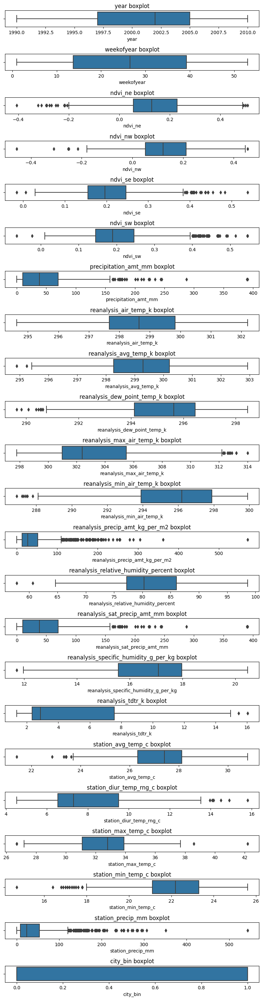

In [ ]:
# Crear una figura con subplots para cada variable
fig, axes = plt.subplots(len(num_columns), 1, figsize=(8, 30))
# Iterar por cada variable y graficar un boxplot
for i, column in enumerate(num_columns):
    sns.boxplot(x=train[column], ax=axes[i])
    axes[i].set_title(f"{column} boxplot")
plt.tight_layout()
plt.show()

In [ ]:
# Calcular el rango intercuartílico y la mediana de la variable "ndvi_ne"
q1 = train["ndvi_ne"].quantile(0.25)
q3 = train["ndvi_ne"].quantile(0.75)
iqr = q3 - q1
median = train["ndvi_ne"].median()

# Seleccionar los valores fuera del rango IQR ± 1.5 * IQR
outliers = train[(train["ndvi_ne"] < q1 - 1.5 * iqr) | (train["ndvi_ne"] > q3 + 1.5 * iqr)]["ndvi_ne"]
print(outliers)

189    -0.290200
519    -0.287000
655    -0.243900
668    -0.206350
705    -0.217950
711    -0.268300
723    -0.406250
725     0.493400
821    -0.308400
860    -0.276100
872    -0.215600
911    -0.251700
929    -0.321400
1370    0.501029
1413    0.508357
Name: ndvi_ne, dtype: float64


**Análisis de Outliers:**

Primero se realizará el análisis de los datos fuera de rango para las variables del índice NDVI en diferentes puntos cardinales. Al observar estas cuatro variables junto con los datos fuera de rango se tienen las opciones de eliminarlos, corregirlos o mantenerlos. Al revisar cada diagrama de cajas se considera que estos valores fuera de rango pueden ser de ocasionados a días con mayor o menor intensidad lumínica que pudo afectar la salud de la planta y arrojar índices NDVI fuera de lo común, además de, estar asociado con otras variables cómo calidad del suelo, fuentes hídricas del subsuelo y actividades antrópicas que tambíen pueden hacer variar este índice. Por esto se decide conservar estos datos fuera de rango para las variables de índice NDVI en cada punto cardinal.

Para las variables de precipitación se hace un análisis similar dado que pueden ser eventos puntuales de grandes lluvias o fenómenos asociados con lluvias torrenciales en la zona. Se sabe que las ciudad están ubicadas en una zona tropical que se ve afectada por temporadas de intensas lluvias, así que estos datos fuera de rango pueden ser picos de precipitación ocasionados por estos eventos.

Ahora, al revisar las demás variables, se observan que los datos fuera de rango no se encuentran tan alejados de la mediana y el promedio de los datos, dado que no se considerará la eliminación de estos datos.

## **Análisis por Mapa de Calor de Correlaciones**

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Calcular la matriz de correlación de Pearson entre las variables numéricas
corr_matrix = train.corr()

Text(0.5, 1.0, 'Mapa de Calor de Correlaciones')

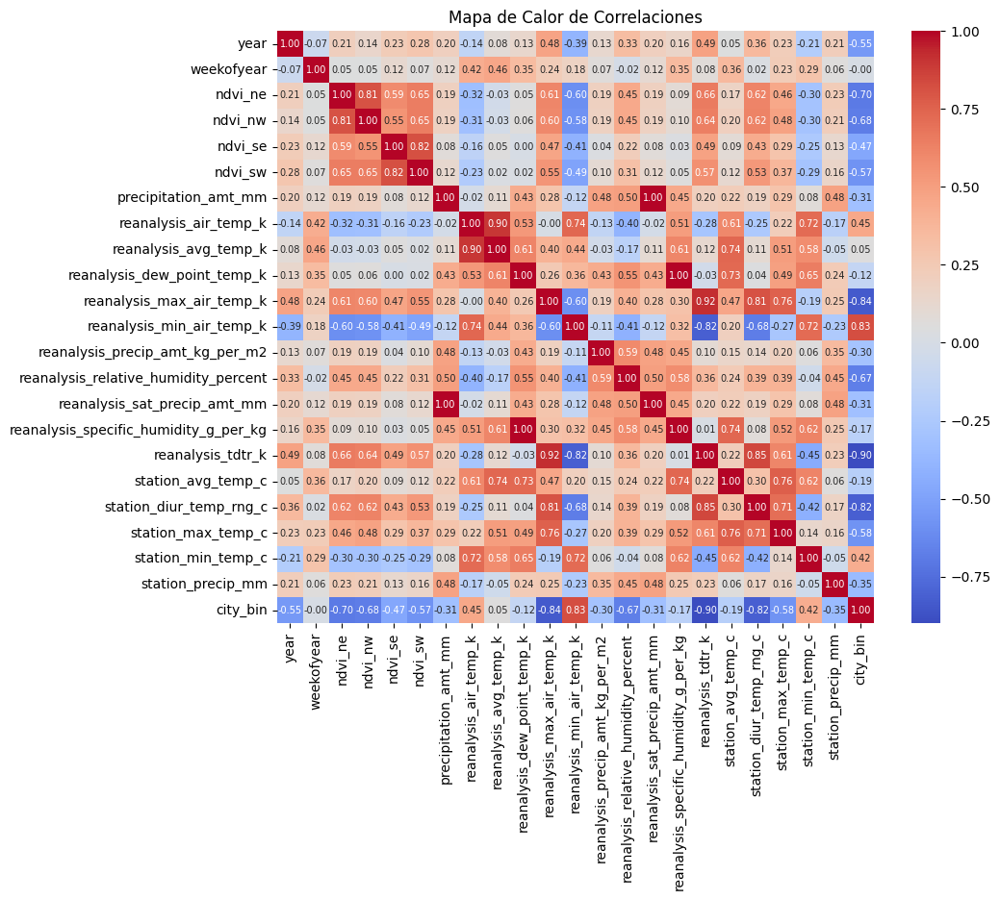

In [ ]:
# Crear un mapa de calor de las correlaciones usando la librería Seaborn
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap="coolwarm", fmt='.2f', annot_kws={'size': 7})

# Agregar un título al mapa de calor
plt.title("Mapa de Calor de Correlaciones")

In [ ]:
# Obtener la matriz de correlaciones
corr_matrix = train.corr()

In [ ]:
# Filtrar las correlaciones mayores o iguales a 0.80
high_corr = corr_matrix.where(np.triu(corr_matrix >= 0.80, k=1)).stack()
low_corr = corr_matrix.where(np.triu(corr_matrix <= -0.80, k=1)).stack()

In [ ]:
# Mostrar las variables con alta correlación
print(high_corr)

ndvi_ne                      ndvi_nw                                  0.812690
ndvi_se                      ndvi_sw                                  0.820953
precipitation_amt_mm         reanalysis_sat_precip_amt_mm             1.000000
reanalysis_air_temp_k        reanalysis_avg_temp_k                    0.901750
reanalysis_dew_point_temp_k  reanalysis_specific_humidity_g_per_kg    0.997048
reanalysis_max_air_temp_k    reanalysis_tdtr_k                        0.918469
                             station_diur_temp_rng_c                  0.811803
reanalysis_min_air_temp_k    city_bin                                 0.825313
reanalysis_tdtr_k            station_diur_temp_rng_c                  0.845560
dtype: float64


In [ ]:
# Mostrar las variables con baja correlación
print(low_corr)

reanalysis_max_air_temp_k  city_bin            -0.838587
reanalysis_min_air_temp_k  reanalysis_tdtr_k   -0.815224
reanalysis_tdtr_k          city_bin            -0.899435
station_diur_temp_rng_c    city_bin            -0.815202
dtype: float64


**Explicación:**

El uso de un mapa de calor de correlaciones en el dataset "train" es útil para identificar las relaciones lineales entre las variables numéricas. El mapa de calor puede ayudar a visualizar rápidamente las variables que están altamente correlacionadas entre sí, lo que puede indicar una dependencia entre ellas. Además, el mapa de calor puede ser utilizado para detectar variables redundantes que podrían ser eliminadas para reducir la complejidad del modelo y evitar problemas de multicolinealidad.

Se identificaron las variables con una correlación mayor al 80% y se observa que la mayoría de ellas están relacionadas con temperatura, por otro lado, las variables con menor correlación tienen en común la variable "city_bin" y tambíen están presentes variables relacionadas con temperatura del aire. Adicionalmente, en las variables con alta correlación, se identifican 8 variables con una correlación superior al 90% y se podría sugerir que son variables candidato para realizar la predicción de la variable objetivo.

-precipitation_amt_mm----reanalysis_sat_precip_amt_mm----1.000000

-reanalysis_air_temp_k----reanalysis_avg_temp_k----0.901750

-reanalysis_dew_point_temp_k----reanalysis_specific_humidity_g_per_kg----0.997048

-reanalysis_max_air_temp_k----reanalysis_tdtr_k----0.918469

## **Análisis por Componentes Principales**

In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# Seleccionar todas las columnas de "train" excepto la columna "city"
cols_to_scale = [col for col in train.columns if col != "city"]

In [ ]:
# Escalar los datos
scaler = StandardScaler()
train_scaled = scaler.fit_transform(train[cols_to_scale])

In [ ]:
# Crear un objeto PCA con el número de componentes principales igual al número de variables
pca = PCA(n_components=5)

In [ ]:
# Ajustar y transformar los datos escalados utilizando PCA
train_pca = pca.fit_transform(train_scaled)

Text(4.3, 0.8233349839788004, '81.33% varianza total explicada')

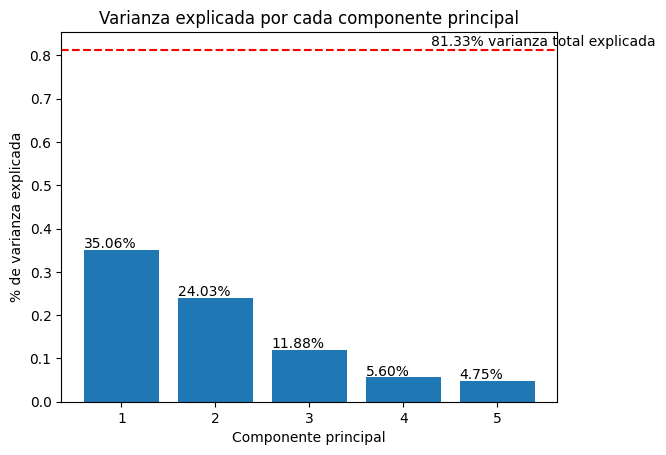

In [ ]:
import matplotlib.pyplot as plt

# Crear un gráfico de barras de la varianza explicada por cada componente principal
plt.bar(range(1, pca.n_components_+1), pca.explained_variance_ratio_)
plt.xlabel("Componente principal")
plt.ylabel("% de varianza explicada")
plt.title("Varianza explicada por cada componente principal")

# Agregar el valor del porcentaje de varianza explicada a cada barra
for i, percentage in enumerate(pca.explained_variance_ratio_):
    plt.text(i+0.6, percentage+0.005, f"{percentage:.2%}", fontsize=10)

# Calcular la suma acumulada del porcentaje de varianza explicada
cumulative_var = np.cumsum(pca.explained_variance_ratio_)

# Agregar la suma total de varianza explicada al gráfico
plt.axhline(y=cumulative_var[-1], color='r', linestyle='--')
plt.text(pca.n_components_ - 0.7, cumulative_var[-1] + 0.01, 
         f"{cumulative_var[-1]:.2%} varianza total explicada", fontsize=10)

In [ ]:
# Imprimir los coeficientes de cada variable en cada componente principal
for i, component in enumerate(pca.components_):
    print(f"Componente principal {i+1}:")
    for j, variable in enumerate(train.columns[:23]):
        print(f"\t{variable}: {component[j]:.3f}")
    print("\n")

**Explicación:**

El análisis de componentes principales se utilizó en el dataset "train" para reducir la dimensionalidad de los datos y resumir la información en un conjunto más pequeño de variables. Esto permite identificar patrones subyacentes en los datos y ayuda a reducir la complejidad del análisis. Además, PCA ayuda a eliminar la multicolinealidad entre las variables, lo que mejora la interpretación de los resultados del modelo y puede reducir el riesgo de sobreajuste. En resumen, el análisis de componentes principales es una herramienta útil para explorar y analizar grandes conjuntos de datos, y puede ayudar a identificar las variables más importantes para explicar la variabilidad en los datos.

En este análisis se observa que usando 5 componentes principales se puede llegar a un 81.33% de explicación de la varianza del conjunto de datos, reduciendo la cantidad de variables de 24 a 5. Aunque tener más de 80% de explicación de la varianza es un buen indicador para un modelo de predicción, se debe tener en cuenta que hay un 20% de error o imprecisión, es decir, para mejorar este valor se deben generar más componentes principales, pero desde el quinto PCA en adelante los porcentajes de explicación de la varianza son muy bajos y no aportan significativamente a este valor.

## **K-means clustering para reducción de variables**

In [ ]:
from sklearn.cluster import KMeans

# Seleccionar solo las variables numéricas del dataset
num_columns = train.select_dtypes(include='number').columns.tolist()
X_train = train[num_columns].drop('city_bin', axis=1)

In [ ]:
# Aplicar K-means clustering con k=5
kmeans = KMeans(n_clusters=5, random_state=42).fit(X_train)

/usr/local/lib/python3.9/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [ ]:
# Identificar las 5 variables más importantes para separar los clusters
n_features = 5
important_features = []
for i, cluster_center in enumerate(kmeans.cluster_centers_):
    top_features = X_train.columns[np.argsort(cluster_center)[-n_features:]].tolist()
    important_features.append(top_features)

In [ ]:
# Mostrar las variables seleccionadas por clúster
for i, cluster_features in enumerate(important_features):
    print(f"Variables más importantes para el cluster {i+1}: {cluster_features}")

Variables más importantes para el cluster 1: ['reanalysis_dew_point_temp_k', 'reanalysis_air_temp_k', 'reanalysis_avg_temp_k', 'reanalysis_max_air_temp_k', 'year']
Variables más importantes para el cluster 2: ['reanalysis_min_air_temp_k', 'reanalysis_air_temp_k', 'reanalysis_avg_temp_k', 'reanalysis_max_air_temp_k', 'year']
Variables más importantes para el cluster 3: ['reanalysis_dew_point_temp_k', 'reanalysis_air_temp_k', 'reanalysis_avg_temp_k', 'reanalysis_max_air_temp_k', 'year']
Variables más importantes para el cluster 4: ['reanalysis_dew_point_temp_k', 'reanalysis_air_temp_k', 'reanalysis_avg_temp_k', 'reanalysis_max_air_temp_k', 'year']
Variables más importantes para el cluster 5: ['reanalysis_dew_point_temp_k', 'reanalysis_air_temp_k', 'reanalysis_avg_temp_k', 'reanalysis_max_air_temp_k', 'year']


**Explicación**

El uso de técnicas de clustering, como el k-means, permite agrupar observaciones similares en clústeres, lo que permite identificar patrones y relaciones entre variables en los datos. Una vez que se han agrupado las variables en clústeres, se pueden seleccionar las variables más importantes en función de su capacidad para distinguir entre los diferentes grupos. De esta manera, se puede reducir la dimensionalidad del conjunto de datos original y seleccionar solo las variables más importantes que pueden ayudar a predecir la variable objetivo.

A continuación se presentan las variables en común resultantes de este análisis para 5 clusteres:

1.   reanalysis_dew_point_temp_k
2.   reanalysis_air_temp_k
1.   reanalysis_avg_temp_k
2.   reanalysis_max_air_temp_k
1.   year


## **Clustering jerárquico para reducción de variables**

In [ ]:
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
import matplotlib.pyplot as plt

# Seleccionar solo las variables numéricas del dataset
num_columns = train.select_dtypes(include='number').columns.tolist()
X_train = train[num_columns].drop('city_bin', axis=1)

In [ ]:
# Calcular la matriz de distancia y aplicar clustering jerárquico
Z = linkage(X_train, 'ward')

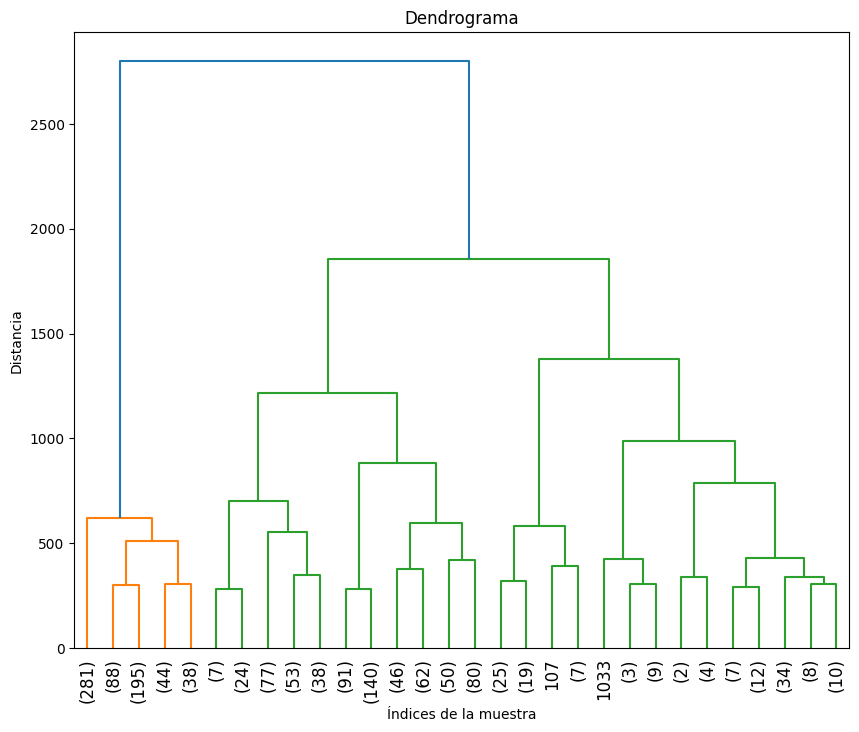

In [ ]:
# Visualizar el dendrograma para identificar la cantidad adecuada de clusters
plt.figure(figsize=(10, 8))
dendrogram(Z, truncate_mode='lastp', p=30, leaf_rotation=90., leaf_font_size=12.)
plt.title("Dendrograma")
plt.xlabel("Índices de la muestra")
plt.ylabel("Distancia")
plt.show()

In [ ]:
# Seleccionar la cantidad adecuada de clusters basados en el dendrograma
num_clusters = 5

In [ ]:
# Aplicar clustering jerárquico con el número de clusters seleccionado
labels = fcluster(Z, num_clusters, criterion='maxclust')

In [ ]:
# Identificar las variables más importantes para separar los clusters
important_features = []
for i in range(1, num_clusters+1):
    cluster_indices = np.where(labels == i)[0]
    cluster_data = X_train.iloc[cluster_indices]
    cluster_std = cluster_data.std()
    top_feature = cluster_std.idxmax()
    important_features.append(top_feature)

In [ ]:
# Mostrar las variables seleccionadas
print("Variables seleccionadas:", important_features)

Variables seleccionadas: ['reanalysis_precip_amt_kg_per_m2', 'station_precip_mm', 'reanalysis_precip_amt_kg_per_m2', 'reanalysis_precip_amt_kg_per_m2', 'station_precip_mm']


**Explicación**

El clustering jerárquico es un método de análisis de datos no supervisado que agrupa objetos similares en clusters. En el contexto de reducción de variables, el clustering jerárquico puede ser utilizado para identificar grupos de variables que están altamente correlacionadas y que, por lo tanto, pueden ser consideradas redundantes. Identificar estas variables redundantes es importante porque puede ayudar a simplificar el análisis y reducir el riesgo de sobreajuste. Además, al agrupar variables similares, también podemos identificar variables clave que tienen un mayor impacto en la variabilidad de los datos y, por lo tanto, pueden ser más importantes para el análisis en cuestión.

Las variables resultantes de este análisis son:

1.   reanalysis_precip_amt_kg_per_m2
2.   station_precip_mm







## **Clustering Basado en Densidad**

In [ ]:
from sklearn.cluster import DBSCAN

# Seleccionar solo las variables numéricas del dataset
num_columns = train.select_dtypes(include='number').columns.tolist()
X_train = train[num_columns].drop('city_bin', axis=1)

In [ ]:
# Aplicar DBSCAN clustering
dbscan = DBSCAN(eps=15, min_samples=5).fit(X_train)

In [ ]:
# Identificar las variables más importantes para separar los clusters
labels = dbscan.labels_
n_clusters = len(set(labels)) - (1 if -1 in labels else 0)  # calcular número de clusters, ignorando los ruidosos
important_features = []
for i in range(n_clusters):
    cluster_indices = np.where(labels == i)[0]
    cluster_data = X_train.iloc[cluster_indices]
    cluster_std = cluster_data.std()
    top_feature = cluster_std.idxmax()
    important_features.append(top_feature)

In [ ]:
# Mostrar las variables seleccionadas
print("Variables seleccionadas:", important_features)

Variables seleccionadas: ['precipitation_amt_mm', 'weekofyear', 'reanalysis_precip_amt_kg_per_m2', 'station_precip_mm', 'station_precip_mm', 'station_precip_mm', 'reanalysis_relative_humidity_percent', 'precipitation_amt_mm', 'station_precip_mm', 'station_precip_mm', 'weekofyear']


**Explicación:**

El método de clustering basado en densidad es una técnica útil para la identificación de grupos en un conjunto de datos con distribución irregular. Es particularmente útil cuando se desconoce el número de grupos en los datos o cuando los grupos tienen formas y tamaños variables. Además, a diferencia de otros métodos de clustering, este método no requiere que los grupos sean de forma esférica o estén bien separados.

En el caso del dataset "train", que contiene múltiples variables numéricas que pueden estar correlacionadas de manera compleja, el método de clustering basado en densidad podría ayudar a identificar patrones complejos en los datos que no serían evidentes de otra manera. Esto podría ser útil para identificar relaciones entre variables que podrían ser importantes para predecir la variable objetivo. Además, al reducir el número de variables, el método de clustering basado en densidad también podría mejorar el rendimiento de los modelos de aprendizaje automático que se construyen con el conjunto de datos.

Los resultados de este análisis son:

1.   precipitation_amt_mm
1.   weekofyear
1.   reanalysis_precip_amt_kg_per_m2
2.   station_precip_mm
2.   reanalysis_relative_humidity_percent




In [ ]:
# Conjunto de características seleccionadas:
selected_features = ['reanalysis_relative_humidity_percent', 'reanalysis_avg_temp_k', 'reanalysis_air_temp_k', 'reanalysis_dew_point_temp_k', 'reanalysis_precip_amt_kg_per_m2', 'year', 'weekofyear']

In [ ]:
# EJEMPLO: Normalización con MinMaxScaler
#from sklearn.preprocessing import MinMaxScaler
#scaler = MinMaxScaler()
#X_train = scaler.fit_transform(train[selected_features])
#X_train

---
# Conclusiones
---

**Resultados de la experimentación**:

Al realizar cada uno de los experimentos de correlación e identificación de variables con mayor importante en el conjunto de datos, se hizo una comparación de cada uno de ellos y se evaluó su grado de correlación en el mapa de calor de corrlaciones. A continuación, se presentan las variables elegidas según los resultados de cada método de análisis.

* Lista de características:


1.   reanalysis_relative_humidity_percent
2.   reanalysis_avg_temp_k
3.   reanalysis_air_temp_k
4.   reanalysis_dew_point_temp_k
5.   reanalysis_precip_amt_kg_per_m2
6.   year
7.   weekofyear



* Resumen dataset (transformaciones, etc.):

El dataset tuvo ligeros cambios en un comienzo, se eliminó una variable relacionada con la fecha de inicio de semana, luego se usó un binarizador para la variable city y así tener la información de ciudad como dato numérico, se identificaron datos faltantes y se imputaron usando la mediana de cada variable, luego se identificaron datos fuera de rango y se llegó a la conclusión de mantenerlos.

El mapa de calor de correlaciones se puede utilizar para la reducción de variables mediante la identificación de variables altamente correlacionadas. Si dos variables tienen una correlación muy alta, es posible que una de ellas no sea necesaria para la explicación de la varianza en los datos, por lo que puede eliminarse. También puede ayudar a identificar variables redundantes que pueden ser eliminadas para reducir la dimensionalidad del conjunto de datos.

El análisis de componentes principales (PCA) es otro método común de reducción de variables. PCA es una técnica de transformación lineal que toma un conjunto de variables y las transforma en un conjunto de componentes principales no correlacionados que explican la mayor parte de la varianza en los datos originales. Al reducir la dimensionalidad del conjunto de datos mediante la eliminación de componentes menos importantes, PCA puede mejorar la eficiencia del análisis y reducir el riesgo de sobreajuste. Así, para este caso se redujo la cantidad de variables de 24 a 5.

Las variables seleccionadas corresponden a variables climáticas que pueden estar asociadas con la propagación del virus del dengue. La temperatura es un factor crítico para el ciclo de vida de los mosquitos que transmiten la enfermedad, ya que su desarrollo y actividad están influenciados por la temperatura. La humedad también es importante, ya que afecta la supervivencia y el desarrollo de los mosquitos. Además, la precipitación es importante porque puede influir en la cantidad de agua disponible para que los mosquitos depositen sus huevos y se reproduzcan.

Se utilizó clustering jerárquico y se seleccionaron las variables más importantes para separar los clusters. El resultado indica que las variables climáticas seleccionadas son relevantes para agrupar las observaciones en clusters.

Se utilizó el algoritmo DBSCAN con una métrica basada en la silueta y se seleccionaron las variables con mayor puntuación de silueta. Esto indica que estas variables tienen una alta correlación con los clusters formados.

Se utilizó el algoritmo K-means y se seleccionaron las variables que mejor explicaban la varianza en los datos. Las variables climáticas seleccionadas tienen una alta varianza y pueden ser importantes para explicar las diferencias en la propagación del dengue.

Estas variables climáticas seleccionadas tienen un potencial para ser utilizadas en modelos predictivos de la propagación del dengue y pueden ser útiles para mejorar la comprensión de los factores ambientales que influyen en la transmisión del virus.

Para predecir la cantidad de nuevas infecciones de dengue para una semana concreta del año, es recomendable utilizar la variable "weekofyear" en lugar de "year". Esto se debe a que la variable "weekofyear" es más específica y proporciona información detallada sobre el momento exacto del año en el que ocurre la infección. Por otro lado, la variable "year" solo indica el año en que ocurrió la infección y no proporciona información específica sobre el momento en que ocurrió.

Sin embargo, también es posible utilizar ambas variables en conjunto para mejorar la precisión del modelo predictivo, ya que la variable "year" puede proporcionar información adicional sobre tendencias y patrones de infección a lo largo del tiempo.




Una posible planificación preliminar para abordar la experimentación con modelos predictivos podría ser la siguiente:

1. Realizar una exploración de datos detallada para comprender mejor la distribución de las variables, identificar cualquier valor atípico y visualizar cualquier patrón temporal.

2. Preprocesar los datos para tratar cualquier valor faltante, eliminar cualquier variable redundante o no informativa y escalar las variables si es necesario.

3. Dividir los datos en conjuntos de entrenamiento y prueba.

4. Probar varios modelos de regresión diferentes, como regresión lineal, árboles de decisión, bosques aleatorios, redes neuronales y SVM, utilizando las variables seleccionadas como características para predecir el número de casos de dengue.

5. Evaluar el rendimiento de los modelos utilizando medidas de error como el error cuadrático medio y el coeficiente de determinación R-squared.

6. Realizar una validación cruzada para garantizar la robustez del modelo.

7. Realizar una selección de modelos basada en su rendimiento en los conjuntos de entrenamiento y prueba y en la simplicidad del modelo.

8. Ajustar el modelo seleccionado utilizando el conjunto de entrenamiento completo y evaluar su rendimiento en el conjunto de prueba.

9. Interpretar los resultados del modelo y proporcionar recomendaciones para prevenir la propagación del dengue.

Teniendo en cuenta que el número de casos de dengue puede verse afectado por factores ambientales y meteorológicos, se podría explorar la inclusión de variables adicionales en el modelo, como la densidad de población. Además, dado que se trata de un problema de serie temporal, se podría investigar el uso de modelos de series temporales, como el ARIMA y el LSTM, que podrían tener en cuenta la dependencia temporal en los datos.



